This notebook presents the segmentation of a drawing in a single element reduced dataset with an overfitted model.

# Set up the environment

# Training data preparation

In [1]:
!mkdir raw_datasets

mkdir: impossible de créer le répertoire «raw_datasets»: Le fichier existe


## Download datasets

In [2]:
# Download REID2019 dataset

%cd raw_datasets/

# Download REID2019 dataset manually in raw_datasets

#!unzip -q REID2019.zip -d ./
#!unzip -q REID2019/REID2019_ExampleSet.zip -d REID2019/
#!rm REID2019/REID2019_ExampleSet.zip

%cd ../

/home/21804803t@univ-tours.local/Deep-Agora/deep_learning_lab/raw_datasets
/home/21804803t@univ-tours.local/Deep-Agora/deep_learning_lab


In [3]:
# Reduction of REID dataset

%cd raw_datasets/

!cp REID2019/REID2019_ExampleSet/00787297.tif ./
!cp REID2019/REID2019_ExampleSet/00787297.xml ./

!rm -r REID2019/REID2019_ExampleSet/*

!cp 00787297.tif REID2019/REID2019_ExampleSet/
!cp 00787297.xml REID2019/REID2019_ExampleSet/

!rm 00787297.tif
!rm 00787297.xml

%cd ../

/home/21804803t@univ-tours.local/Deep-Agora/deep_learning_lab/raw_datasets
/home/21804803t@univ-tours.local/Deep-Agora/deep_learning_lab


## Patch the datasets

In [4]:
## Patch the datasets

import training_data.pipelines as pipeline

configured_labels = (['ImageRegion'],) # Atomic labels are to be promoted

to_be_patched = {
    #d : pipeline.selectAnnotationsFrom(d) # Interactive
    d : configured_labels
    for d in (
        'reid',
    )
}

for dataset, chosen_annotations in to_be_patched.items():
    for chosen_labels in chosen_annotations:
        pipeline.annotationsToMasks(
            src= dataset,
            names_labels= chosen_labels,
        )

PATCHING REID WITH 'ImageRegion' SPECIFIED LABEL


Building label masks : 100%|████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  3.84it/s]

# Deep learning lab

In [5]:
## Imports

from dh_segment_torch.config import Params
from dh_segment_torch.data import DataSplitter
from dh_segment_torch.data.annotation import AnnotationWriter
from dh_segment_torch.training import Trainer
from dh_segment_torch.inference import PredictProcess
from dh_segment_torch.post_processing import PostProcessingPipeline

In [6]:
import torch
import os

print("=== CUDA device ) selection ===")

assert torch.cuda.device_count() >= 1

print("device 0: ",torch.cuda.get_device_properties(0)) 
print("device 1: ",torch.cuda.get_device_properties(1))

cuda_device = 0
cuda_device_str = str(cuda_device)

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]=cuda_device_str
torch.cuda.set_device(cuda_device)

=== CUDA device ) selection ===
device 0:  _CudaDeviceProperties(name='RTX A6000', major=8, minor=6, total_memory=48685MB, multi_processor_count=84)
device 1:  _CudaDeviceProperties(name='Quadro RTX 8000', major=7, minor=5, total_memory=48601MB, multi_processor_count=72)


In [7]:
print("=== torch cuda ===")

print("cuda:",torch.version.cuda," device = ",torch.cuda.current_device())
print("The selected GPU has %.2f GB of memory."%(torch.cuda.get_device_properties(0).total_memory//1024**2/1000))
print("torch:",torch.__version__)

# type "nvidia-smi" on linux prompt for info about CUDA
print("The GPU has %.2f GB of memory."%(torch.cuda.get_device_properties(0).total_memory//1024**2/1000))

=== torch cuda ===
cuda: 11.3  device =  0
The selected GPU has 48.69 GB of memory.
torch: 1.12.1
The GPU has 48.69 GB of memory.


In [8]:
import pandas as pd
import numpy as np
from PIL import Image, ImageDraw, ImageColor
import os, glob, json, cv2, collections, torch

## Training parameters

The aim here is to overtrain the model, just to see if it works.

In [9]:
## Loading data

folder_name = '_ImageRegion_'

params = {
    'data_path' : os.path.join(folder_name, 'data'), # Path to write the data
    'data_splitter': {'train_ratio': 1.00, 'val_ratio': 0.00, 'test_ratio': 0.00}, # splitting ratio of the data
}

data_path = params.pop("data_path")

In [10]:
## Process parameters

relative_path = params.pop("relative_path", True)

params.setdefault("labels_dir", os.path.join(data_path, "labels"))
labels_dir = params.get("labels_dir")

params.setdefault("images_dir", os.path.join(data_path, "images"))
images_dir = params.get("images_dir")

params.setdefault("csv_path", os.path.join(data_path, "data.csv"))

data_splitter_params = params.pop("data_splitter", None)
train_csv_path = params.pop("train_csv", os.path.join(data_path, "train.csv"))
val_csv_path = params.pop("val_csv", os.path.join(data_path, "val.csv"))
test_csv_path = params.pop("test_csv", os.path.join(data_path, "test.csv"))

labels_list = sorted(glob.glob(os.path.join(labels_dir, '*.*')))
images_list = sorted(glob.glob(os.path.join(images_dir, '*.*')))

data = pd.DataFrame({'image': images_list, 'label': labels_list})
data.to_csv(params['csv_path'], header=False, index=False)

if relative_path:
    data['image'] = data['image'].apply(lambda path: os.path.join("images", os.path.basename(path)))
    data['label'] = data['label'].apply(lambda path: os.path.join("labels", os.path.basename(path)))
    
## Divide data set in train, validation and test sets
if data_splitter_params:
    data_splitter = DataSplitter.from_params(data_splitter_params)
    data_splitter.split_data(data, train_csv_path, val_csv_path, test_csv_path)

In [11]:
## Training params

params = {
    "color_labels": {"label_json_file": os.path.join(data_path, "classfile.json")}, # Color labels produced before
    "train_dataset": {
        "type": "image_csv", # Image csv dataset
        "csv_filename": os.path.join(data_path, "train.csv"),
        "base_dir": data_path,
        "repeat_dataset": 4, # Repeat 4 times the data since we have little
        "compose": {"transforms": [{"type": "fixed_size_resize", "output_size": 1e6}]} # Resize to a fixed size, could add other transformations.
    },
    "val_dataset": {
        "type": "image_csv", # Validation dataset
        "csv_filename": os.path.join(data_path, "train.csv"), #"val.csv"), in order to overtrain the model
        "base_dir": data_path,
        "compose": {"transforms": [{"type": "fixed_size_resize", "output_size": 1e6}]}
    },
    "model": { # Model definition, original dhSegment
        "encoder": "resnet50", 
        "decoder": {
            "decoder_channels": [512, 256, 128, 64, 32],
            "max_channels": 512
        }
    },
    "metrics": [['miou', 'iou'], ['iou', {"type": 'iou', "average": None}], 'precision'], # Metrics to compute
    "optimizer": {"lr": 1e-4}, # Learning rate
    "lr_scheduler": {"type": "exponential", "gamma": 0.9995}, # Exponential decreasing learning rate
    "val_metric": "+miou", # Metric to observe to consider a model better than another, the + indicates that we want to maximize
    "early_stopping": {"patience": 4}, # Number of validation steps without increase to tolerate, stops if reached
    "model_out_dir": "model_test", # Path to model output
    "num_epochs": 100, # Number of epochs for training
    "evaluate_every_epoch": 5, # Number of epochs between each validation of the model
    "batch_size": 3, # Batch size (to be changed if the allocated GPU has little memory)
    "num_data_workers": 0,
    "track_train_metrics": False,
    "loggers": [
        {"type": 'tensorboard', "log_dir": os.path.join('.', 'tensorboard', 'log'), "log_every": 5, "log_images_every": 10}, # Tensorboard logging
        ]
}

## Training

In [12]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [13]:
!rm -r tensorboard
!rm -r model_test

In [14]:
## Train

trainer = Trainer.from_params(params)
trainer.train()

{'color_labels': {'label_json_file': '_ImageRegion_/data/classfile.json'}, 'train_dataset': {'type': 'image_csv', 'csv_filename': '_ImageRegion_/data/train.csv', 'base_dir': '_ImageRegion_/data', 'repeat_dataset': 4, 'compose': {'transforms': [{'type': 'fixed_size_resize', 'output_size': 1000000.0}]}}, 'val_dataset': {'type': 'image_csv', 'csv_filename': '_ImageRegion_/data/train.csv', 'base_dir': '_ImageRegion_/data', 'compose': {'transforms': [{'type': 'fixed_size_resize', 'output_size': 1000000.0}]}}, 'model': {'encoder': 'resnet50', 'decoder': {'decoder_channels': [512, 256, 128, 64, 32], 'max_channels': 512}}, 'metrics': [['miou', 'iou'], ['iou', {'type': 'iou', 'average': None}], 'precision'], 'optimizer': {'lr': 0.0001}, 'lr_scheduler': {'type': 'exponential', 'gamma': 0.9995}, 'val_metric': '+miou', 'early_stopping': {'patience': 4}, 'model_out_dir': 'model_test', 'num_epochs': 100, 'evaluate_every_epoch': 5, 'batch_size': 3, 'num_data_workers': 0, 'track_train_metrics': False,

epoch 0: loss=???:   0%|          | 0/100 [00:00<?, ?it/s]

iter=0: loss=???: 0it [00:00, ?it/s]

iter=2: loss=???: 0it [00:00, ?it/s]

iter=4: loss=???: 0it [00:00, ?it/s]

iter=6: loss=???: 0it [00:00, ?it/s]

iter=8: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=10: loss=???: 0it [00:00, ?it/s]

iter=12: loss=???: 0it [00:00, ?it/s]

iter=14: loss=???: 0it [00:00, ?it/s]

iter=16: loss=???: 0it [00:00, ?it/s]

iter=18: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=20: loss=???: 0it [00:00, ?it/s]

iter=22: loss=???: 0it [00:00, ?it/s]

iter=24: loss=???: 0it [00:00, ?it/s]

iter=26: loss=???: 0it [00:00, ?it/s]

iter=28: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=30: loss=???: 0it [00:00, ?it/s]

iter=32: loss=???: 0it [00:00, ?it/s]

iter=34: loss=???: 0it [00:00, ?it/s]

iter=36: loss=???: 0it [00:00, ?it/s]

iter=38: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=40: loss=???: 0it [00:00, ?it/s]

iter=42: loss=???: 0it [00:00, ?it/s]

iter=44: loss=???: 0it [00:00, ?it/s]

iter=46: loss=???: 0it [00:00, ?it/s]

iter=48: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=50: loss=???: 0it [00:00, ?it/s]

iter=52: loss=???: 0it [00:00, ?it/s]

iter=54: loss=???: 0it [00:00, ?it/s]

iter=56: loss=???: 0it [00:00, ?it/s]

iter=58: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=60: loss=???: 0it [00:00, ?it/s]

iter=62: loss=???: 0it [00:00, ?it/s]

iter=64: loss=???: 0it [00:00, ?it/s]

iter=66: loss=???: 0it [00:00, ?it/s]

iter=68: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=70: loss=???: 0it [00:00, ?it/s]

iter=72: loss=???: 0it [00:00, ?it/s]

iter=74: loss=???: 0it [00:00, ?it/s]

iter=76: loss=???: 0it [00:00, ?it/s]

iter=78: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

Tried to delete model_test/best_trainer_checkpoint_miou=0.712.pth and model_test/best_model_checkpoint_miou=0.712.pth but did not exist


iter=80: loss=???: 0it [00:00, ?it/s]

iter=82: loss=???: 0it [00:00, ?it/s]

iter=84: loss=???: 0it [00:00, ?it/s]

iter=86: loss=???: 0it [00:00, ?it/s]

iter=88: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=90: loss=???: 0it [00:00, ?it/s]

iter=92: loss=???: 0it [00:00, ?it/s]

iter=94: loss=???: 0it [00:00, ?it/s]

iter=96: loss=???: 0it [00:00, ?it/s]

iter=98: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=100: loss=???: 0it [00:00, ?it/s]

iter=102: loss=???: 0it [00:00, ?it/s]

iter=104: loss=???: 0it [00:00, ?it/s]

iter=106: loss=???: 0it [00:00, ?it/s]

iter=108: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=110: loss=???: 0it [00:00, ?it/s]

iter=112: loss=???: 0it [00:00, ?it/s]

iter=114: loss=???: 0it [00:00, ?it/s]

iter=116: loss=???: 0it [00:00, ?it/s]

iter=118: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=120: loss=???: 0it [00:00, ?it/s]

iter=122: loss=???: 0it [00:00, ?it/s]

iter=124: loss=???: 0it [00:00, ?it/s]

iter=126: loss=???: 0it [00:00, ?it/s]

iter=128: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=130: loss=???: 0it [00:00, ?it/s]

iter=132: loss=???: 0it [00:00, ?it/s]

iter=134: loss=???: 0it [00:00, ?it/s]

iter=136: loss=???: 0it [00:00, ?it/s]

iter=138: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=140: loss=???: 0it [00:00, ?it/s]

iter=142: loss=???: 0it [00:00, ?it/s]

iter=144: loss=???: 0it [00:00, ?it/s]

iter=146: loss=???: 0it [00:00, ?it/s]

iter=148: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=150: loss=???: 0it [00:00, ?it/s]

iter=152: loss=???: 0it [00:00, ?it/s]

iter=154: loss=???: 0it [00:00, ?it/s]

iter=156: loss=???: 0it [00:00, ?it/s]

iter=158: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=160: loss=???: 0it [00:00, ?it/s]

iter=162: loss=???: 0it [00:00, ?it/s]

iter=164: loss=???: 0it [00:00, ?it/s]

iter=166: loss=???: 0it [00:00, ?it/s]

iter=168: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=170: loss=???: 0it [00:00, ?it/s]

iter=172: loss=???: 0it [00:00, ?it/s]

iter=174: loss=???: 0it [00:00, ?it/s]

iter=176: loss=???: 0it [00:00, ?it/s]

iter=178: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=180: loss=???: 0it [00:00, ?it/s]

iter=182: loss=???: 0it [00:00, ?it/s]

iter=184: loss=???: 0it [00:00, ?it/s]

iter=186: loss=???: 0it [00:00, ?it/s]

iter=188: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

iter=190: loss=???: 0it [00:00, ?it/s]

iter=192: loss=???: 0it [00:00, ?it/s]

iter=194: loss=???: 0it [00:00, ?it/s]

iter=196: loss=???: 0it [00:00, ?it/s]

iter=198: loss=???: 0it [00:00, ?it/s]

Evaluating: 0it [00:00, ?it/s]

In [15]:
%tensorboard --logdir model_cadaster_test/log

ERROR: Timed out waiting for TensorBoard to start. It may still be running as pid 47878.

## Inference parameters

In [40]:
## Inference params

dataset_params = {
    "type": "folder",
    "folder": os.path.join(data_path, 'images'),
    "pre_processing": {"transforms": []}
}

model_params = {
    "model": {
            "encoder": "resnet50",
            "decoder": {"decoder_channels": [512, 256, 128, 64, 32], "max_channels": 512}
        },
        "num_classes": 2,
        "model_state_dict": sorted(glob.glob(os.path.join('model_test', 'best_model_checkpoint_miou=*.pth')))[-1],
        "device": "cuda:0"
}

process_params = Params({
    'data': dataset_params,
    'model': model_params,
    'batch_size': 1,
    'num_workers': 0,
    'add_path': True
})

## Inference

In [41]:
output_dir = "predictions"
os.makedirs(output_dir, exist_ok=True)

predict_annots = PredictProcess.from_params(process_params)
predict_annots.process_to_probas_files(output_dir)

{'data': {'type': 'folder', 'folder': '_ImageRegion_/data/images', 'pre_processing': {'transforms': []}}, 'model': {'model': {'encoder': 'resnet50', 'decoder': {'decoder_channels': [512, 256, 128, 64, 32], 'max_channels': 512}}, 'num_classes': 2, 'model_state_dict': 'model_test/best_model_checkpoint_miou=0.958.pth', 'device': 'cuda:0'}, 'batch_size': 1, 'num_workers': 0, 'add_path': True} data
{'folder': '_ImageRegion_/data/images', 'pre_processing': {'transforms': []}} folder
{'transforms': []} transforms
{'model': {'model': {'encoder': 'resnet50', 'decoder': {'decoder_channels': [512, 256, 128, 64, 32], 'max_channels': 512}}, 'num_classes': 2, 'model_state_dict': 'model_test/best_model_checkpoint_miou=0.958.pth', 'device': 'cuda:0'}, 'batch_size': 1, 'num_workers': 0, 'add_path': True} model
{'model': {'encoder': 'resnet50', 'decoder': {'decoder_channels': [512, 256, 128, 64, 32], 'max_channels': 512}}, 'num_classes': 2, 'model_state_dict': 'model_test/best_model_checkpoint_miou=0.95

  0%|          | 0/1 [00:00<?, ?it/s]

## Visualise the results

In [42]:
results = [np.load(path) for path in sorted(glob.glob(os.path.join(output_dir, '*.npy')))]
images = [cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB) for path in sorted(glob.glob(os.path.join(data_path, 'images', '*.*')))]

### Comparaison between the original image and the probability map

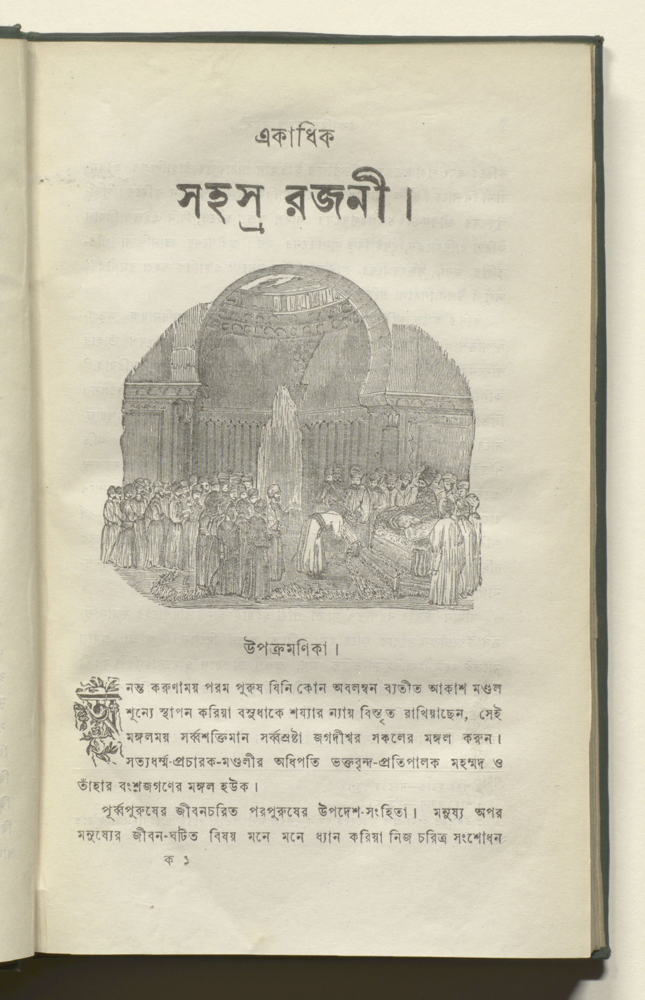

In [50]:
image_nb = 0

Image.fromarray(images[image_nb])

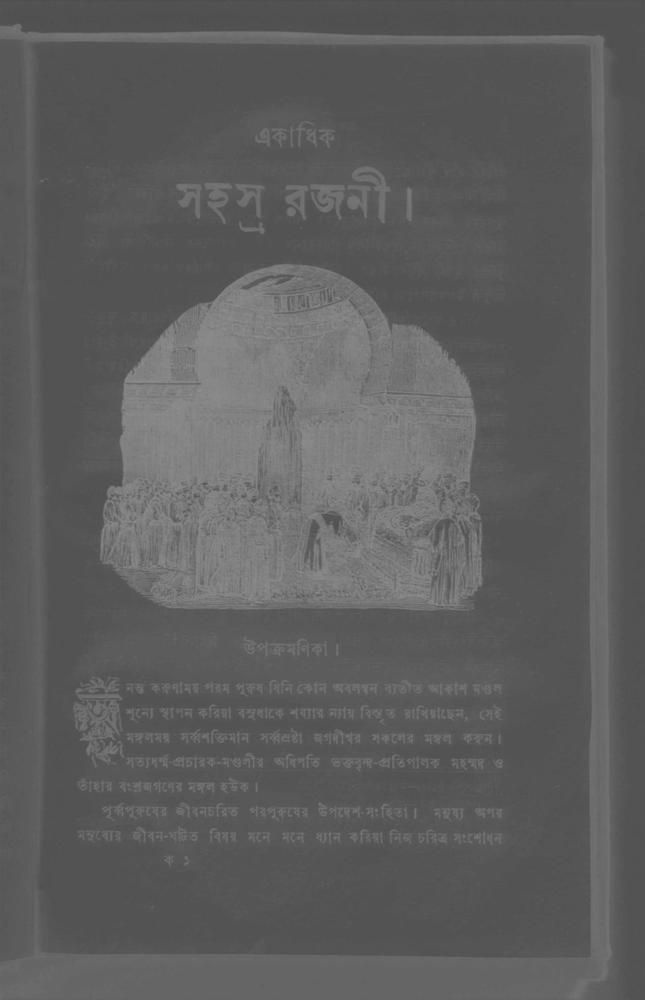

In [44]:
class_nb = 1

Image.fromarray((np.around(results[image_nb][class_nb]*255)).astype('uint8'))

### Focus on the best predictions

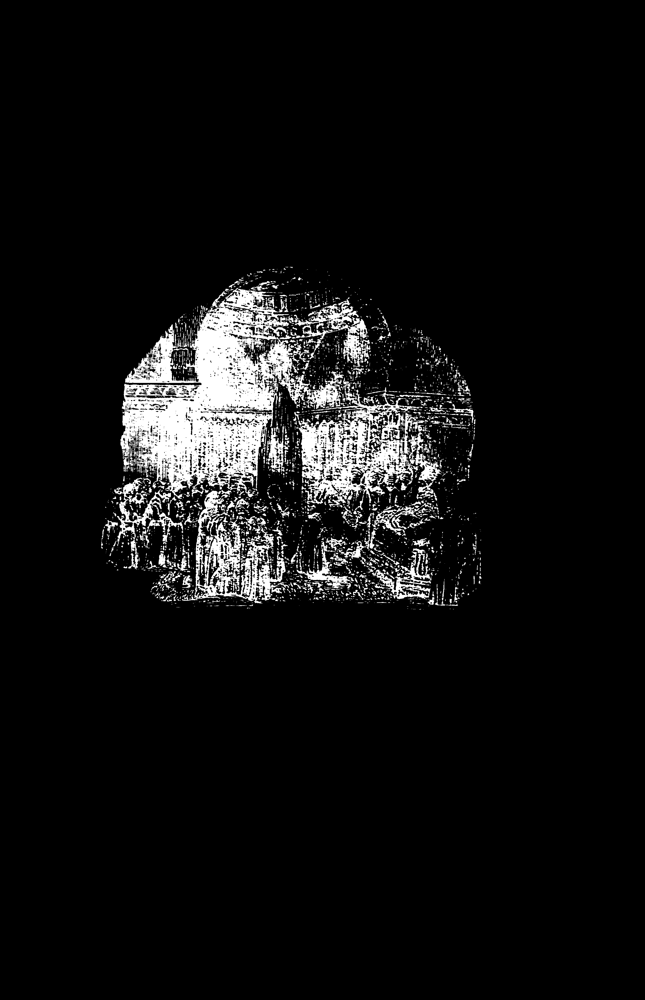

In [45]:
colors = [0, 255]

image = np.argmax(results[image_nb], axis=0).astype('uint8')
canvas = np.zeros((image.shape[0], image.shape[1], 3)).astype('uint8')
for i, color in enumerate(colors):
    canvas[image == i] = color
Image.fromarray(canvas)

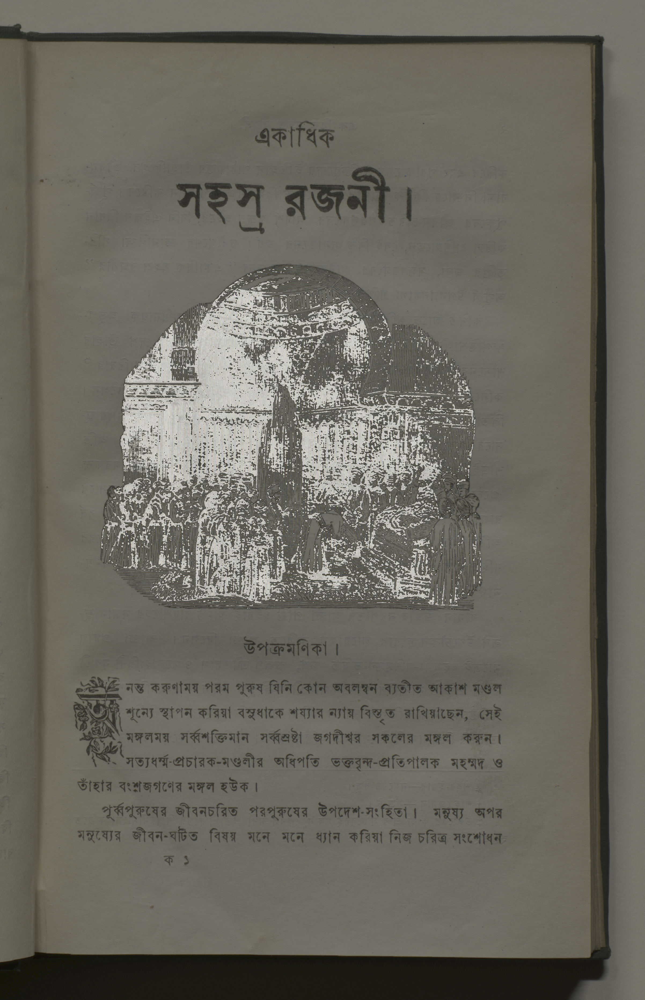

In [46]:
Image.fromarray(canvas//2 + images[image_nb]//2)

### Bounding box

In [47]:
mask = (image == class_nb).astype('uint8')*255
x, y, w, h = cv2.boundingRect(mask)

#### Predictions

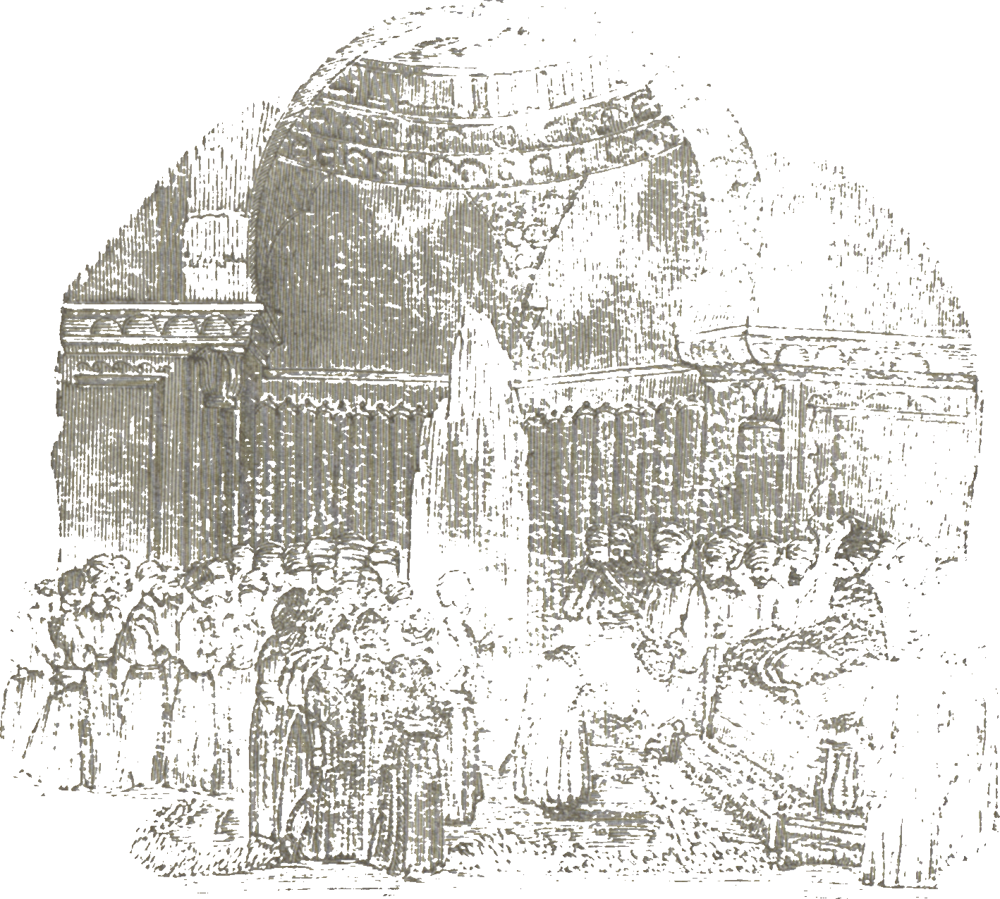

In [48]:
pred_cut = cv2.merge((images[image_nb], mask))[y:y+h, x:x+w]
Image.fromarray(pred_cut)

#### Image

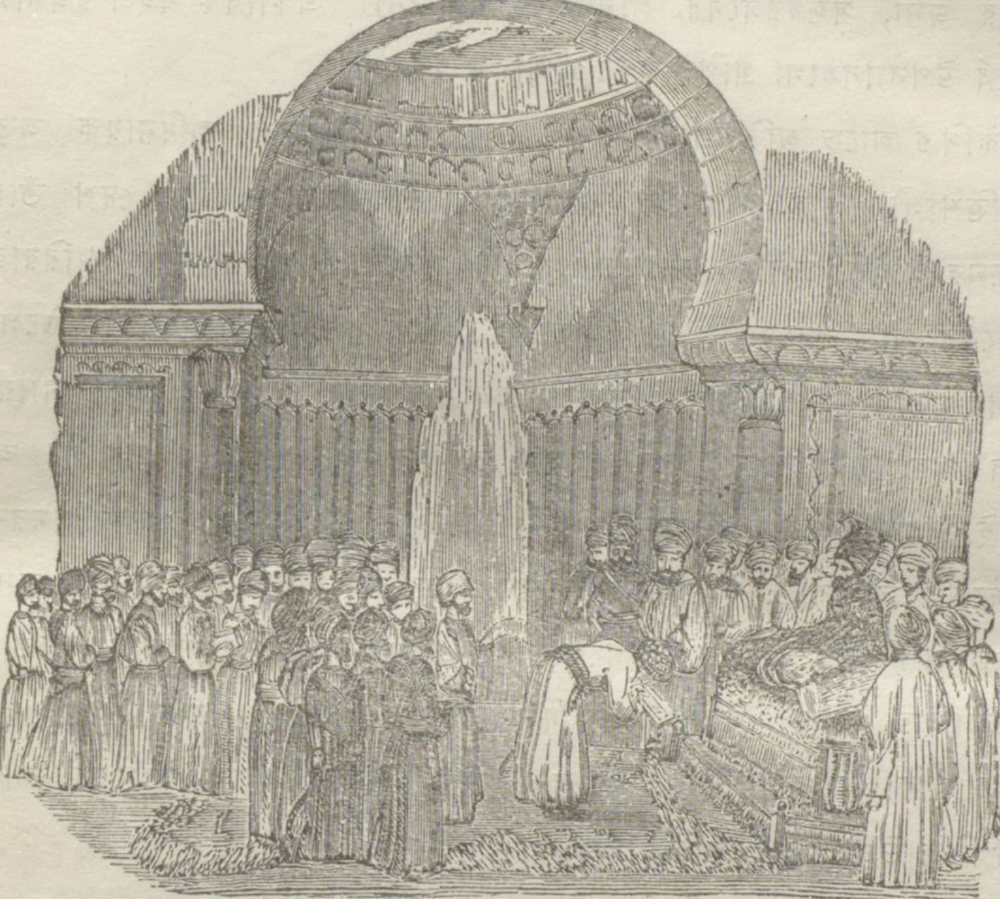

In [49]:
cut = images[image_nb][y:y+h, x:x+w]
Image.fromarray(cut)